# Refine tangram annotations using clustering for lung_s3

In [1]:
slide_id = "lung_s3"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_processed/sdata_{slide_id}.zarr")
sdata

SpatialData object, with associated Zarr store: /Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_processed/sdata_lung_s3.zarr
├── Images
│     ├── 'he': DataTree[cyx] (3, 43270, 26720), (3, 21635, 13360), (3, 10818, 6680), (3, 5409, 3340), (3, 2705, 1670), (3, 1353, 835), (3, 677, 418)
│     └── 'morpho': DataTree[cyx] (5, 37348, 54086), (5, 18674, 27043), (5, 9337, 13521), (5, 4668, 6760), (5, 2334, 3380)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 13) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (275207, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (275207, 8584)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), morpho (Images), st (Points), nucleus_boundaries (Shapes)

In [4]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_37609/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 275207 × 8584
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [5]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,19.574901,Club cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,8.737764,Neuroendocrine cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,24.090059,CD16 NK cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,19.079021,Memory CD4 T cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,25.423266,CD16 NK cell
...,...,...,...,...,...
aaaeddac-1,nucleus_boundaries,morpho,aaaeddac-1,38.586490,Goblet cell
aaaeddad-1,nucleus_boundaries,morpho,aaaeddad-1,24.609702,Neuroendocrine cell
aaaeddae-1,nucleus_boundaries,morpho,aaaeddae-1,25.874608,Red blood cell
aaaeddaf-1,nucleus_boundaries,morpho,aaaeddaf-1,6.908976,CXCL14+POSTN+ fibroblast


In [6]:
adata_ini.var

""
A2ML1
AAMP
AAR2
AARSD1
ABAT
...
ZSCAN26
ZSWIM6
ZUP1
ZYG11B


## 2. Preprocessing

In [7]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,19.574901,Club cell,132
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,8.737764,Neuroendocrine cell,41
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,24.090059,CD16 NK cell,212
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,19.079021,Memory CD4 T cell,184
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,25.423266,CD16 NK cell,244
...,...,...,...,...,...,...
aaaeddac-1,nucleus_boundaries,morpho,aaaeddac-1,38.586490,Goblet cell,81
aaaeddad-1,nucleus_boundaries,morpho,aaaeddad-1,24.609702,Neuroendocrine cell,9
aaaeddae-1,nucleus_boundaries,morpho,aaaeddae-1,25.874608,Red blood cell,76
aaaeddaf-1,nucleus_boundaries,morpho,aaaeddaf-1,6.908976,CXCL14+POSTN+ fibroblast,1


<Axes: >

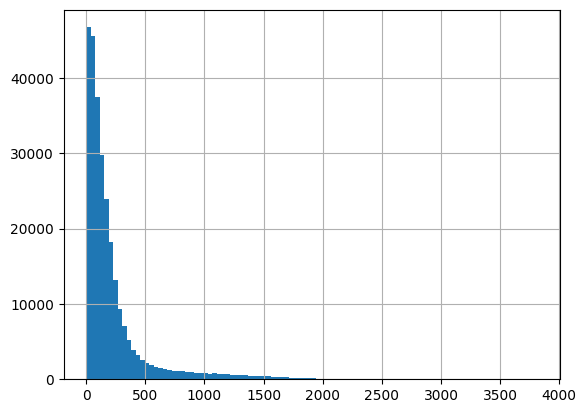

In [8]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

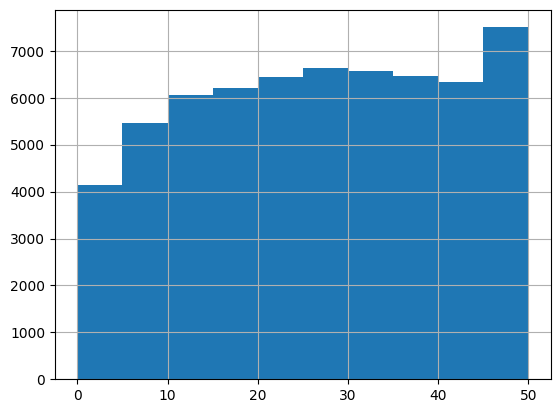

In [9]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [10]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 21879
Percentage of cells with less than 20 transcripts: 7.95%
-----
Number of cells with less than 15 transcripts: 15672
Percentage of cells with less than 15 transcripts: 5.69%
-----
Number of cells with less than 10 transcripts: 9608
Percentage of cells with less than 10 transcripts: 3.49%
-----
Number total of cells: 275207


In [11]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

264419


In [12]:
# Save the raw data
adata.layers['count'] = adata.X.copy()

In [13]:
# Normalize
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['log_norm'] = adata.X.copy()

In [14]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [15]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


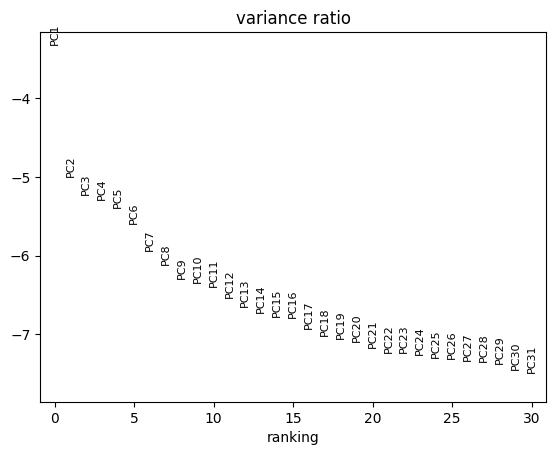

In [16]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata, log=True)

In [17]:
adata

AnnData object with n_obs × n_vars = 264419 × 8584
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts'
    var: 'mean', 'std'
    uns: 'sopa_attrs', 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'tangram_pred', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [18]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [19]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_37609/2486232371.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


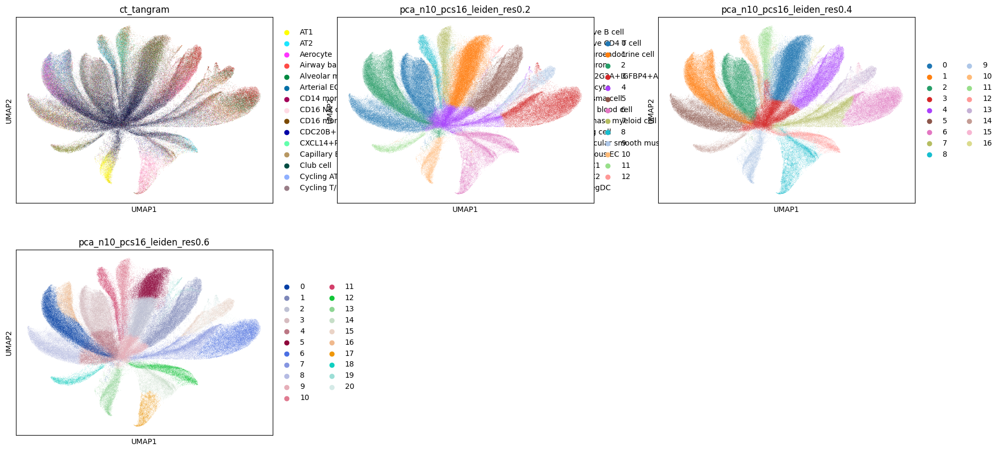

In [20]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3)

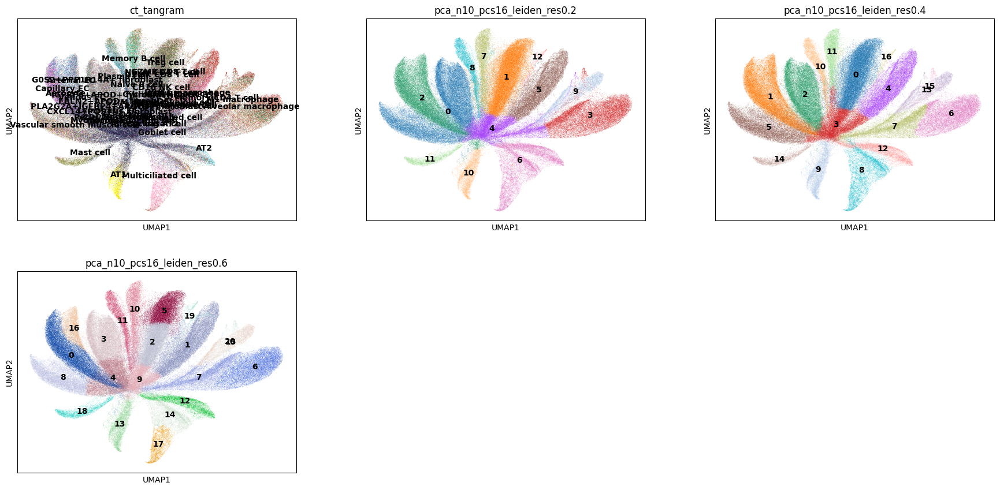

In [21]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [22]:
# Number of clusters
adata.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['0', '3', '5', '11', '6', ..., '14', '8', '13', '12', '9']
Length: 17
Categories (17, object): ['0', '1', '2', '3', ..., '13', '14', '15', '16']

In [23]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['9']), 'refine_res'] = '9'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['10']), 'refine_res'] = '10'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['11']), 'refine_res'] = '11'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['12']), 'refine_res'] = '12'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['13']), 'refine_res'] = '13'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['14']), 'refine_res'] = '14'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['15']), 'refine_res'] = '15'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['16']), 'refine_res'] = '16'

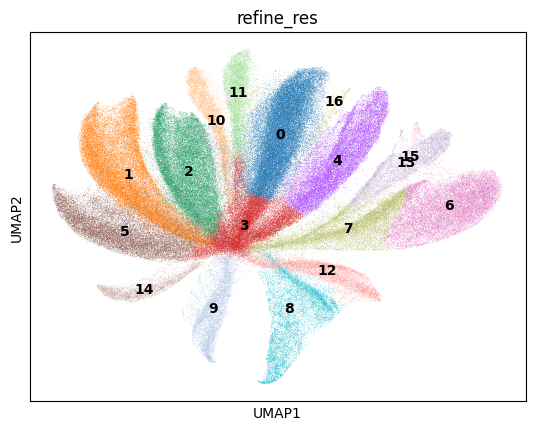

In [24]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [25]:
clustering_label = 'refine_res'

In [26]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_37609/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


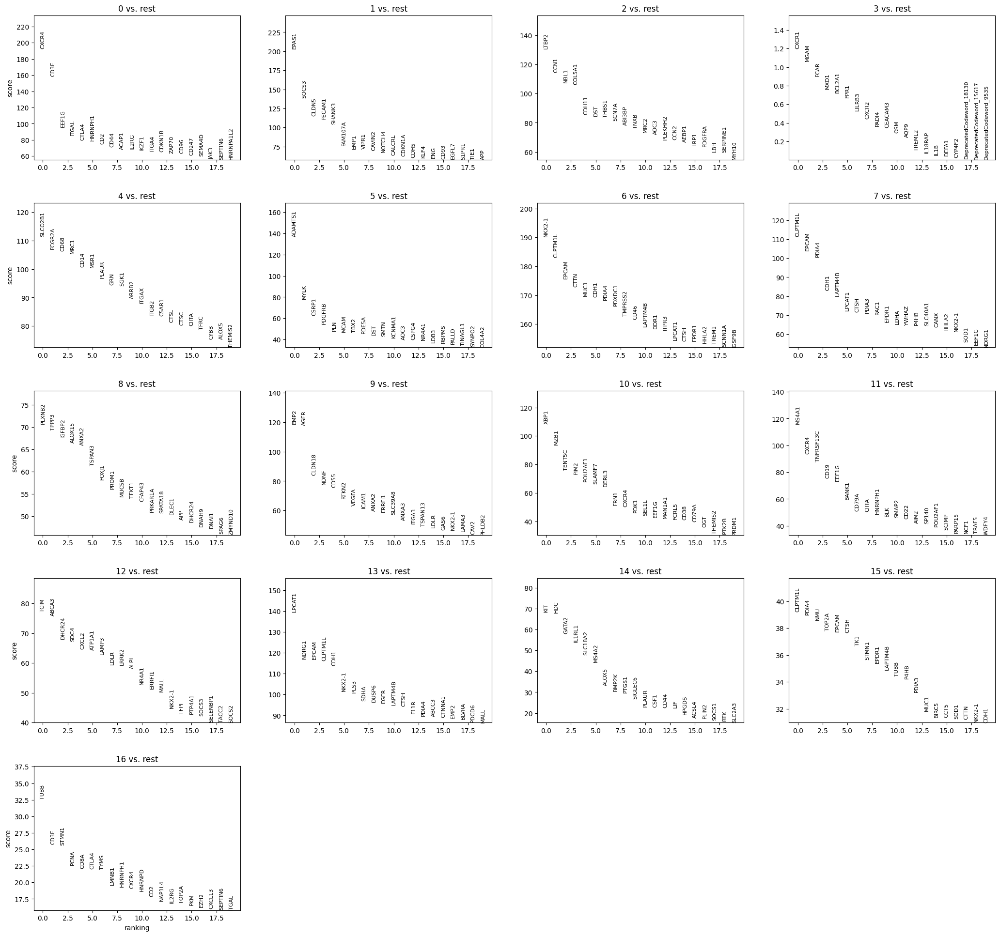

In [27]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [29]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [30]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [42]:
cluster_id = '0'

In [43]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,Neuroendocrine cell,14
1,0,Treg cell,12
2,0,CD16 NK cell,7
3,0,GZMK CD8 T cell,7
4,0,Cycling T/NK cell,4
5,0,GZMB CD8 T cell,4
6,0,Naive B cell,4


In [44]:
top_ranked_genes[cluster_id]

0      CXCR4
1       CD3E
2      EEF1G
3      ITGAL
4      CTLA4
5    HNRNPH1
6        CD2
Name: 0, dtype: object

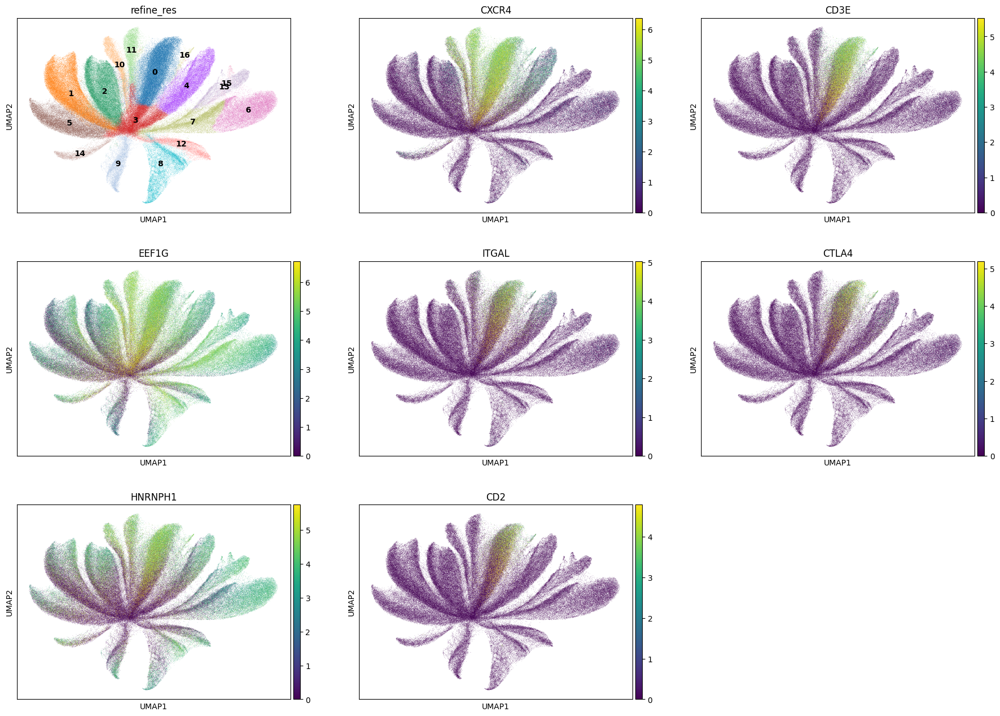

In [45]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [46]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 40653
Percentage of cells in cluster 0: 15.4


In [47]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.2. Cluster 1

In [48]:
cluster_id = '1'

In [49]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,Neuroendocrine cell,23
8,1,Arterial EC,18
9,1,Aerocyte,14
10,1,Capillary EC,11
11,1,Red blood cell,5
12,1,Venous EC,5
13,1,Lymphatic EC,2


In [50]:
top_ranked_genes[cluster_id]

0      EPAS1
1      SOCS3
2      CLDN5
3     PECAM1
4     SHANK3
5    FAM107A
6       EMP1
Name: 1, dtype: object

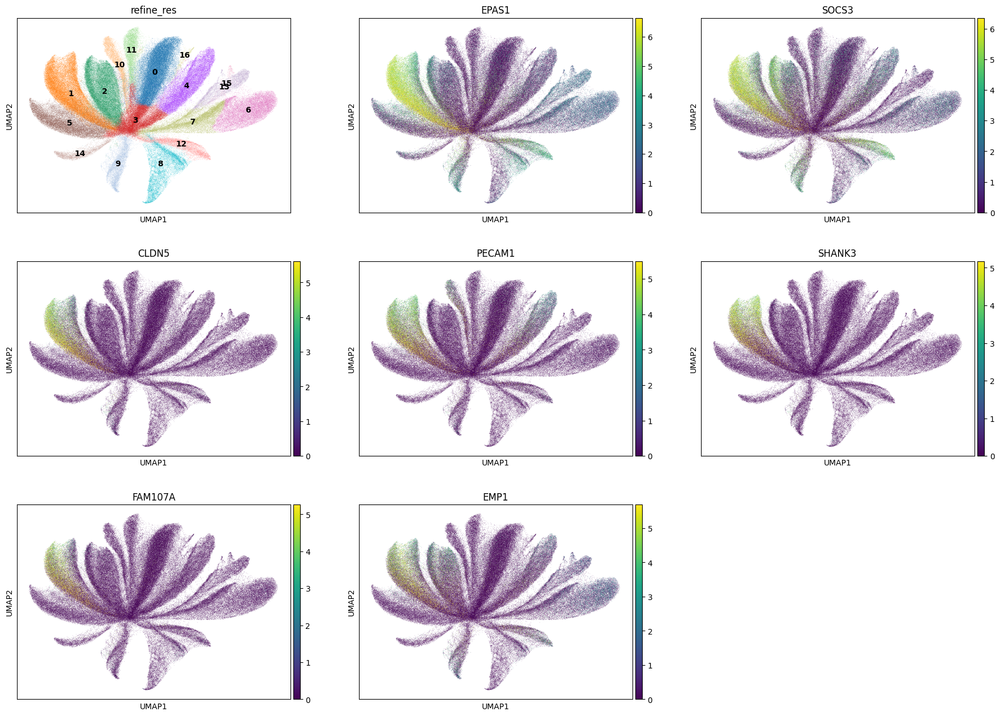

In [51]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [52]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 35244
Percentage of cells in cluster 1: 13.3


In [53]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.3. Cluster 2

In [54]:
cluster_id = '2'

In [55]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,G0S2+PPP1R14A+ fibroblast,21
15,2,Neuroendocrine cell,14
16,2,IGFBP6+APOD+ fibroblast,9
17,2,PLA2G2A+IGFBP4+APOC1+ fibroblast,5
18,2,Naive B cell,4
19,2,CXCL14+POSTN+ fibroblast,4
20,2,FBLN2+APOD+ fibroblast,4


In [56]:
top_ranked_genes[cluster_id]

0     LTBP2
1      CCN1
2      NBL1
3    COL5A1
4     CDH11
5       DST
6     THBS1
Name: 2, dtype: object

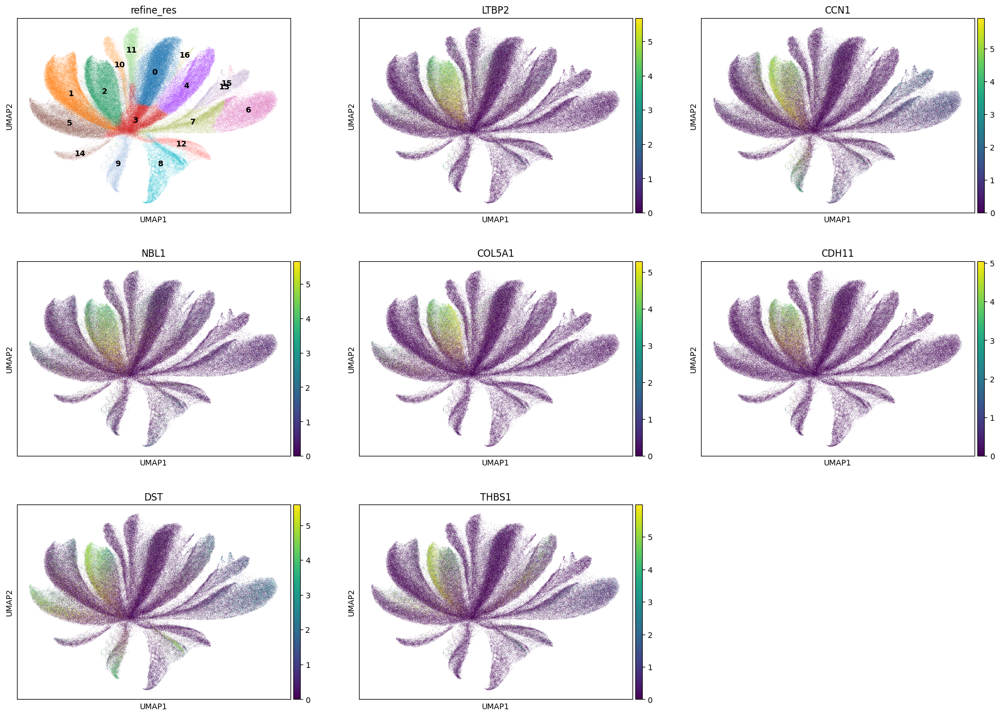

In [57]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 31547
Percentage of cells in cluster 2: 11.9


In [60]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.4. Cluster 3

In [61]:
cluster_id = '3'

In [62]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,Neuroendocrine cell,61
22,3,Red blood cell,8
23,3,cDC1,2
24,3,Neuron,2
25,3,Naive B cell,2
26,3,Cycling T/NK cell,2
27,3,CD16 monocyte,1


In [63]:
top_ranked_genes[cluster_id]

0     CXCR1
1      MGAM
2      FCAR
3      MXD1
4    BCL2A1
5      FPR1
6    LILRB3
Name: 3, dtype: object

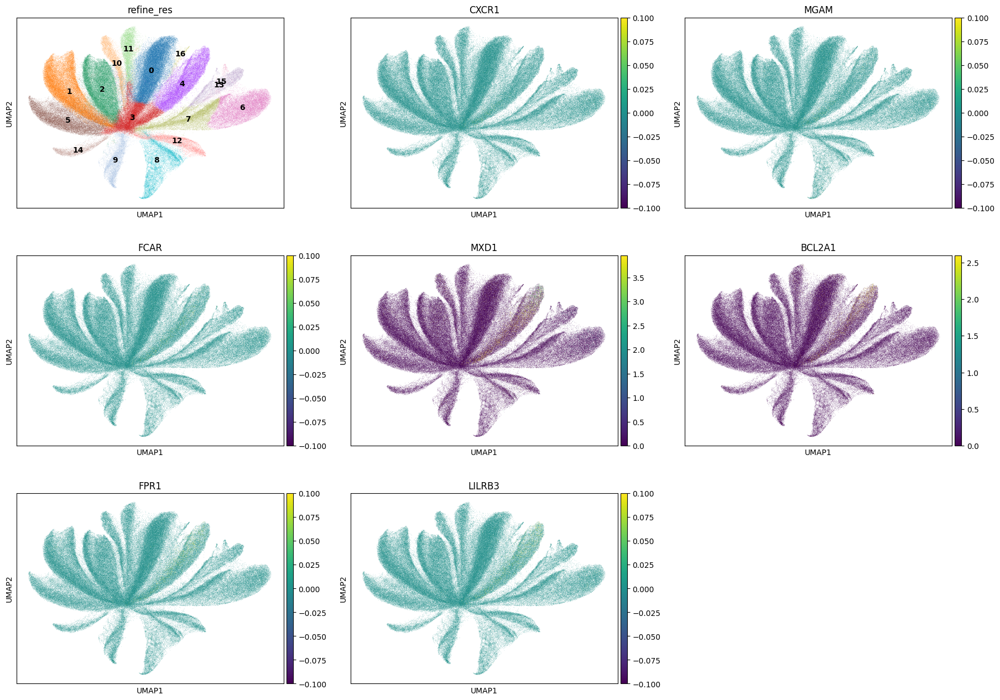

In [64]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 24395
Percentage of cells in cluster 3: 9.2


In [66]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.5. Cluster 4

In [67]:
cluster_id = '4'

In [68]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,M1 macrophage,18
29,4,LYVE1 macrophage,14
30,4,CD16 monocyte,14
31,4,Neuroendocrine cell,10
32,4,cDC2,7
33,4,CD14 monocyte,4
34,4,Red blood cell,3


In [69]:
top_ranked_genes[cluster_id]

0    SLCO2B1
1     FCGR2A
2       CD68
3       MRC1
4       CD14
5       MSR1
6      PLAUR
Name: 4, dtype: object

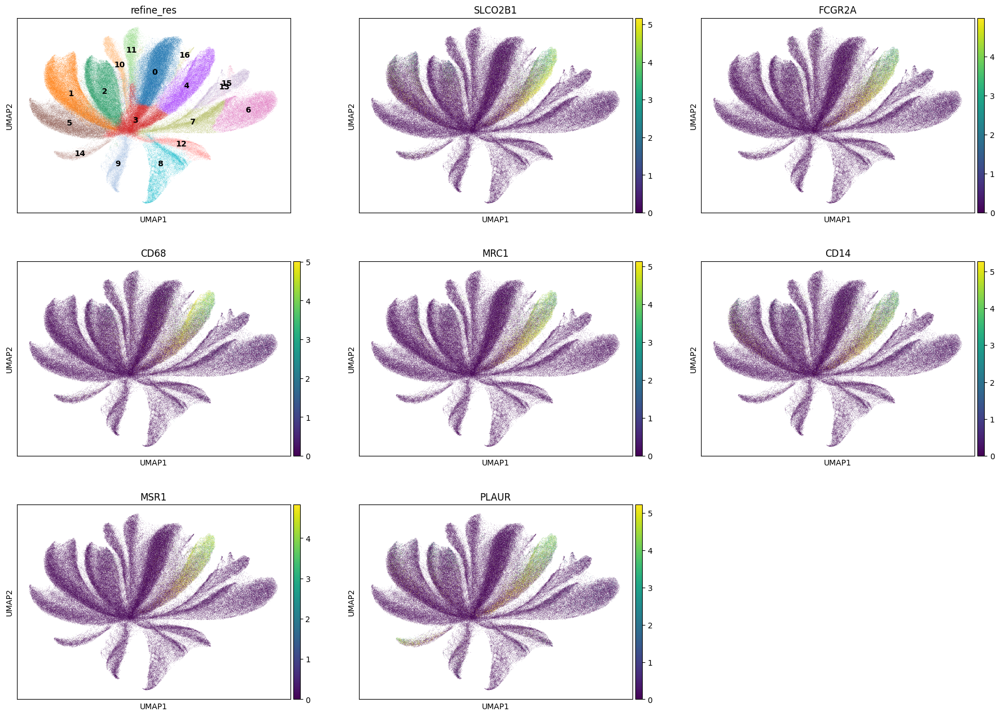

In [70]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 22331
Percentage of cells in cluster 4: 8.4


In [72]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.6. Cluster 5

In [73]:
cluster_id = '5'

In [74]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,Vascular smooth muscle cell,15
36,5,Neuroendocrine cell,14
37,5,Pericyte,10
38,5,Myofibroblast,6
39,5,CXCL14+POSTN+ fibroblast,5
40,5,PLA2G2A+IGFBP4+APOC1+ fibroblast,4
41,5,Red blood cell,4


In [75]:
top_ranked_genes[cluster_id]

0    ADAMTS1
1       MYLK
2      CSRP1
3     PDGFRB
4        PLN
5       MCAM
6       TBX2
Name: 5, dtype: object

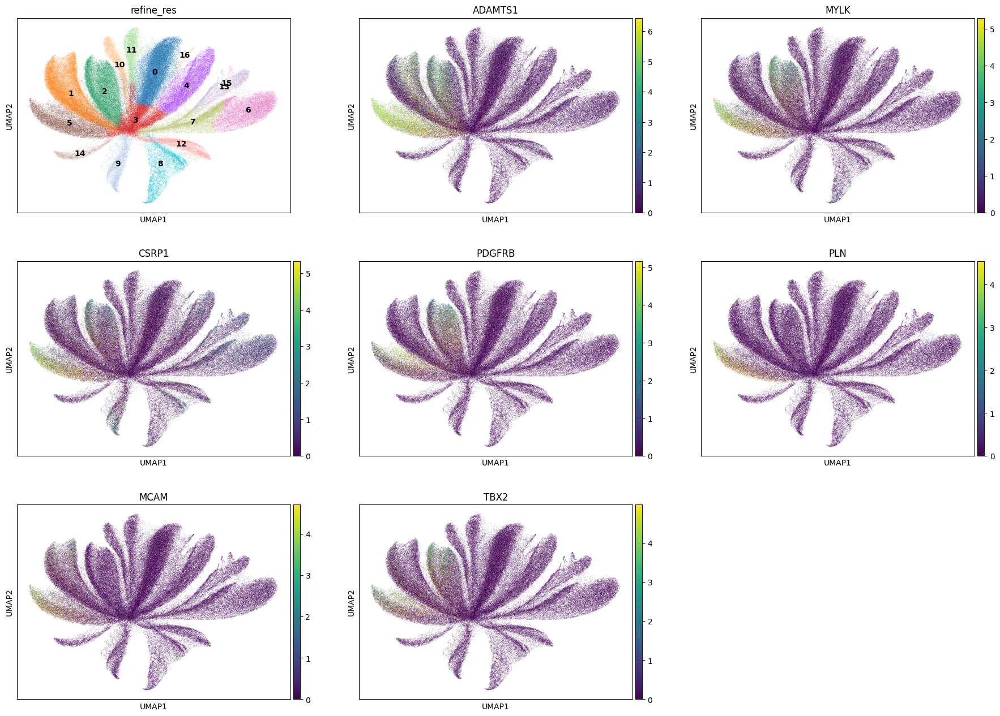

In [76]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 20218
Percentage of cells in cluster 5: 7.6


In [78]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Perivascular'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Pericyte/Smooth_muscle'

### 5.7. Cluster 6

In [79]:
cluster_id = '6'

In [80]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,M1 macrophage,38
43,6,Alveolar macrophage,23
44,6,Memory CD4 T cell,7
45,6,CD16 monocyte,6
46,6,Naive B cell,3
47,6,AT1,3
48,6,CD16 NK cell,3


In [81]:
top_ranked_genes[cluster_id]

0     NKX2-1
1    CLPTM1L
2      EPCAM
3       CTTN
4       MUC1
5       CDH1
6      PDIA4
Name: 6, dtype: object

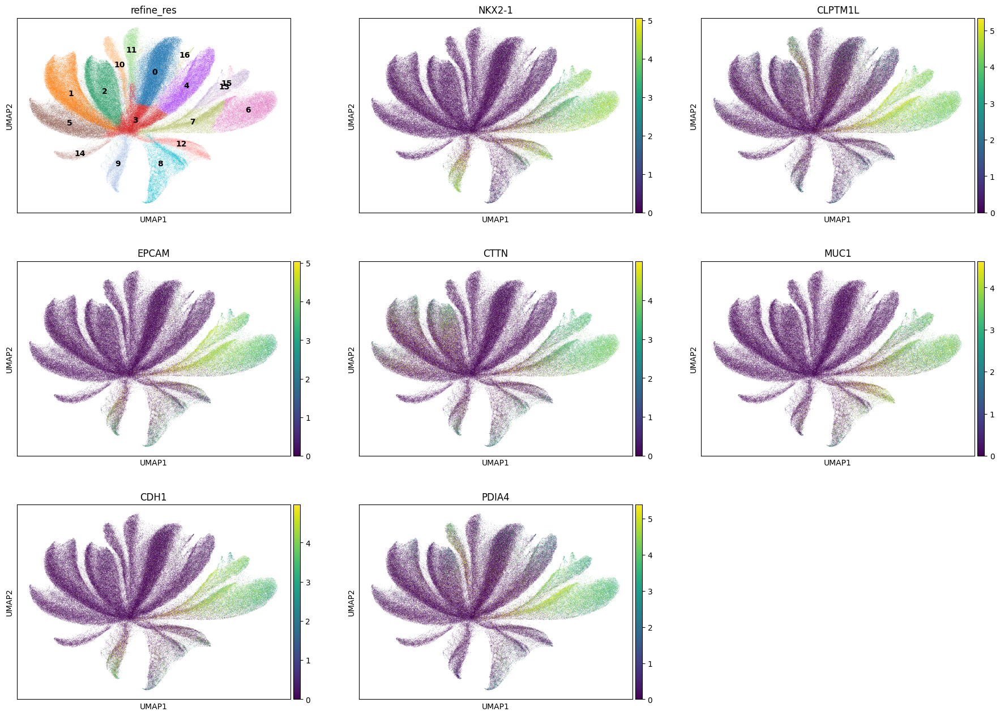

In [82]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [83]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 18817
Percentage of cells in cluster 6: 7.1


In [84]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_epithelial_cell'

### 5.8. Cluster 7

In [85]:
cluster_id = '7'

In [86]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
49,7,Neuroendocrine cell,13
50,7,Red blood cell,6
51,7,CD16 monocyte,4
52,7,Cycling T/NK cell,4
53,7,S phase myeloid cell,4
54,7,CDC20B+ Multiciliated cell,4
55,7,G2/M phase myeloid cell,4


In [87]:
top_ranked_genes[cluster_id]

0    CLPTM1L
1      EPCAM
2      PDIA4
3       CDH1
4    LAPTM4B
5     LPCAT1
6       CTSH
Name: 7, dtype: object

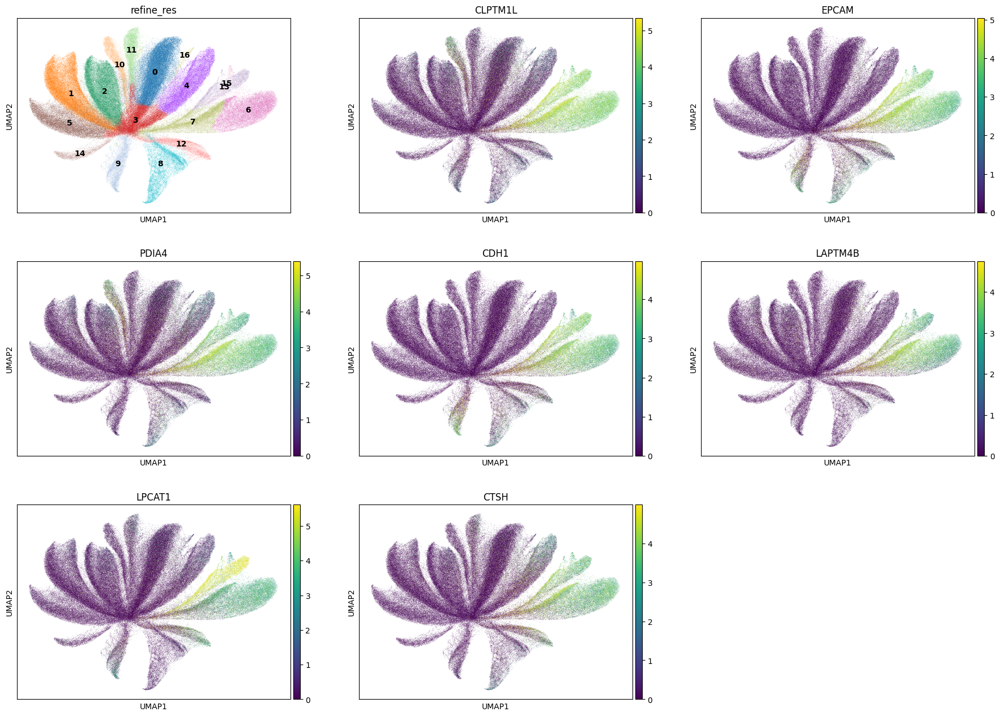

In [88]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [89]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 15447
Percentage of cells in cluster 7: 5.8


In [90]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_epithelial_cell'

### 5.9. Cluster 8

In [91]:
cluster_id = '8'

In [92]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
56,8,Multiciliated cell,44
57,8,CD16 monocyte,7
58,8,Naive B cell,5
59,8,Goblet cell,5
60,8,Airway basal cell,3
61,8,PLA2G2A+IGFBP4+APOC1+ fibroblast,2
62,8,CDC20B+ Multiciliated cell,2


In [93]:
top_ranked_genes[cluster_id]

0    PLXNB2
1     TPPP3
2    IGFBP2
3    ALOX15
4     ANXA2
5    TSPAN3
6     FOXJ1
Name: 8, dtype: object

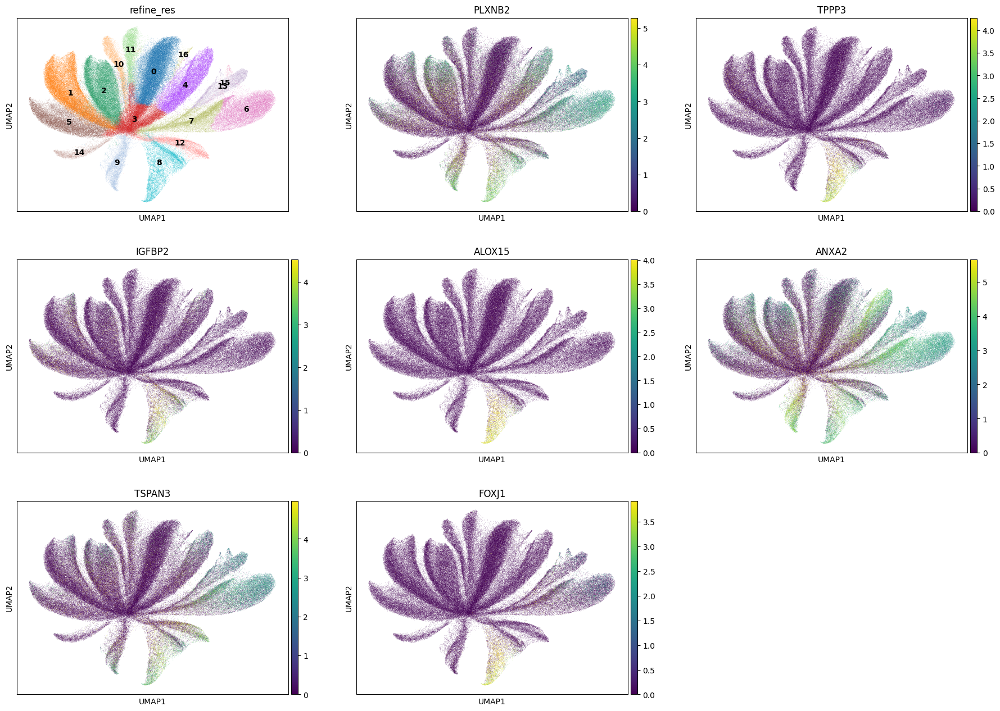

In [94]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [95]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 11075
Percentage of cells in cluster 8: 4.2


In [96]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_ciliated_epithelial_cell'

### 5.10. Cluster 9

In [97]:
cluster_id = '9'

In [98]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
63,9,AT1,41
64,9,Neuroendocrine cell,17
65,9,Red blood cell,7
66,9,CD16 monocyte,2
67,9,Naive B cell,2
68,9,cDC1,2
69,9,CD16 NK cell,1


In [99]:
top_ranked_genes[cluster_id]

0      EMP2
1      AGER
2    CLDN18
3      NDNF
4      CD55
5     RTKN2
6     VEGFA
Name: 9, dtype: object

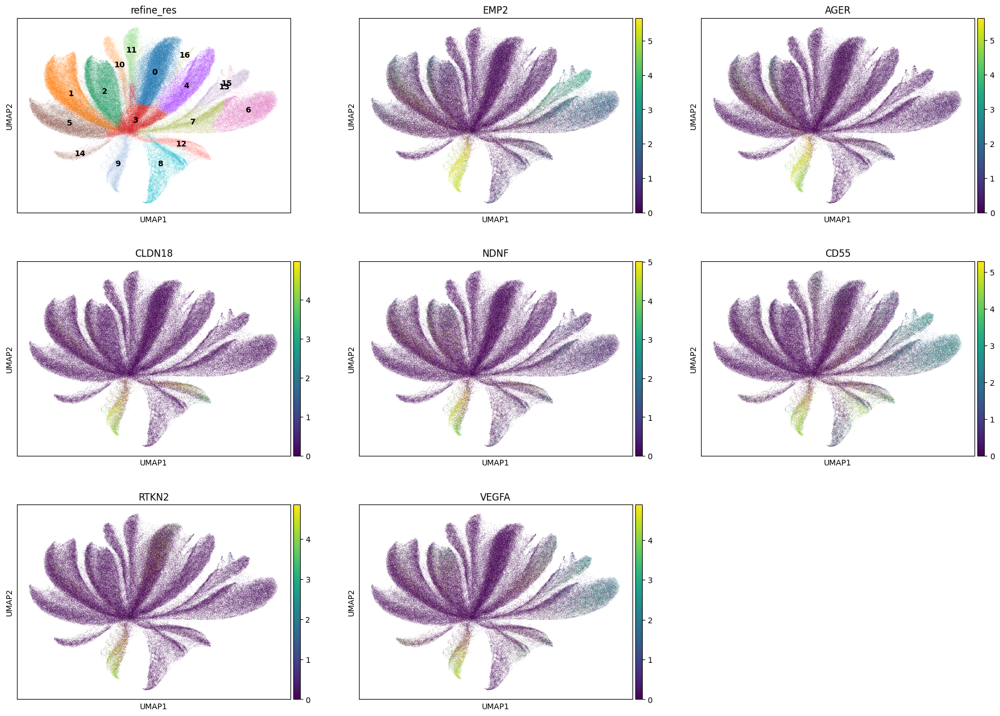

In [100]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [101]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 8448
Percentage of cells in cluster 9: 3.2


In [102]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_alveolar_typeI_epithelial_cell'

### 5.11. Cluster 10

In [103]:
cluster_id = '10'

In [104]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
70,10,Plasma cell,25
71,10,Neuroendocrine cell,15
72,10,Naive B cell,12
73,10,Memory B cell,9
74,10,Red blood cell,5
75,10,CD16 monocyte,3
76,10,Treg cell,2


In [105]:
top_ranked_genes[cluster_id]

0       XBP1
1       MZB1
2     TENT5C
3       PIM2
4    POU2AF1
5     SLAMF7
6      DERL3
Name: 10, dtype: object

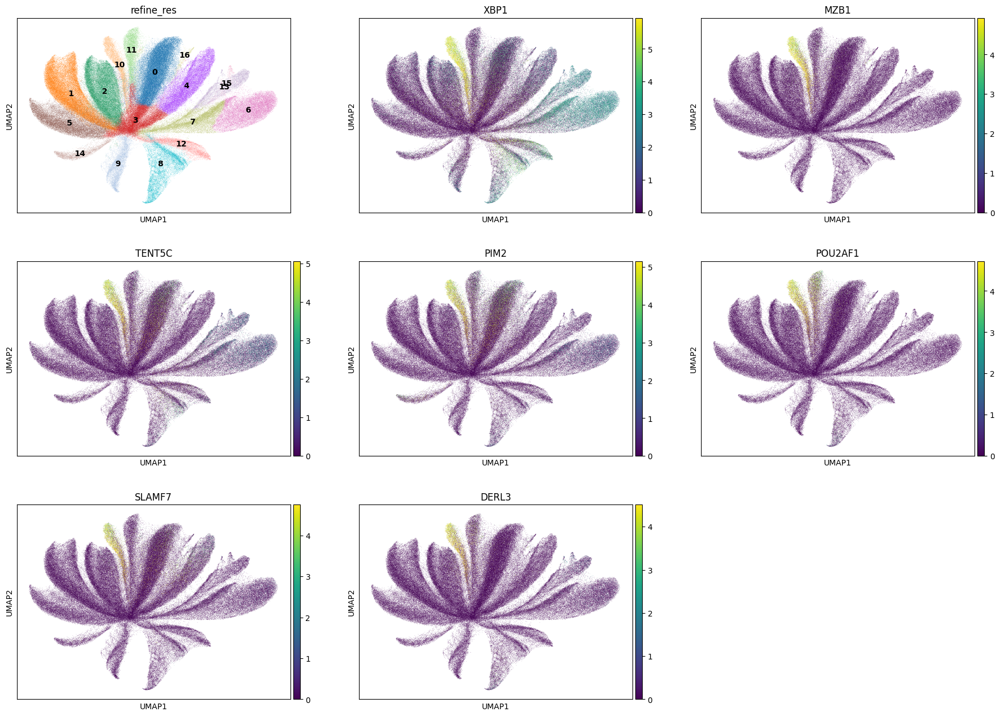

In [106]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [107]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 8348
Percentage of cells in cluster 10: 3.2


In [108]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.12. Cluster 11

In [109]:
cluster_id = '11'

In [110]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
77,11,Memory B cell,44
78,11,Naive B cell,25
79,11,CD16 monocyte,3
80,11,Neuroendocrine cell,3
81,11,CD16 NK cell,2
82,11,Cycling T/NK cell,2
83,11,cDC1,2


In [111]:
top_ranked_genes[cluster_id]

0        MS4A1
1        CXCR4
2    TNFRSF13C
3         CD19
4        EEF1G
5        BANK1
6        CD79A
Name: 11, dtype: object

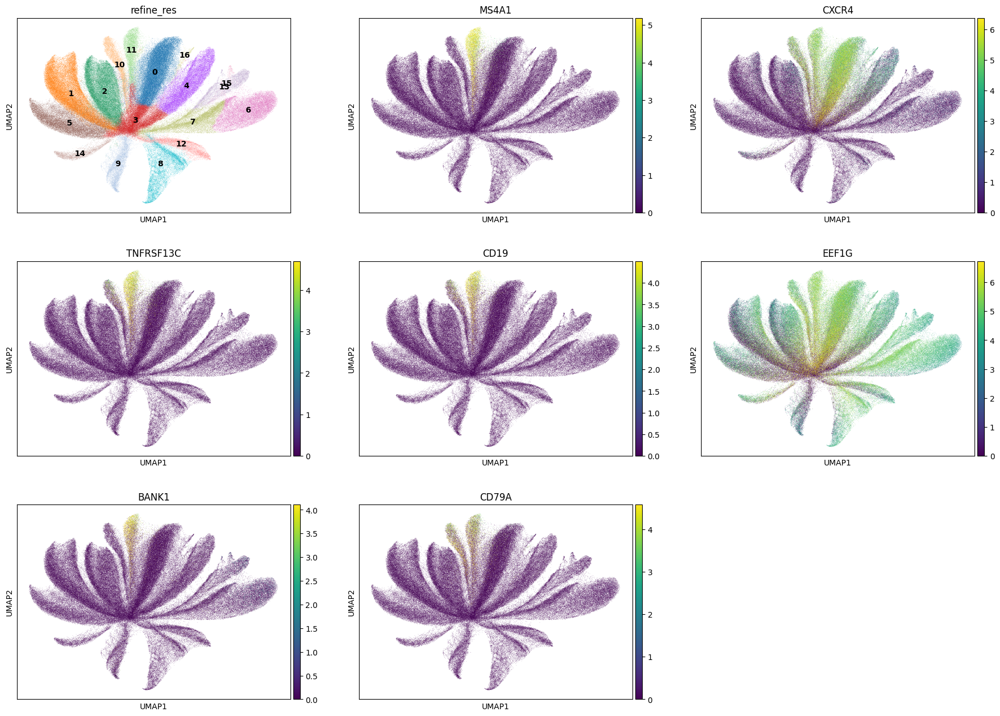

In [112]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [113]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 7821
Percentage of cells in cluster 11: 3.0


In [115]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.13. Cluster 12

In [116]:
cluster_id = '12'

In [117]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
84,12,Neuroendocrine cell,21
85,12,AT2,13
86,12,Red blood cell,8
87,12,CD16 monocyte,3
88,12,CD14 monocyte,3
89,12,LYVE1 macrophage,3
90,12,Naive B cell,3


In [118]:
top_ranked_genes[cluster_id]

0      TCIM
1     ABCA3
2    DHCR24
3      SDC4
4     CXCL2
5    ATP1A1
6     LAMP3
Name: 12, dtype: object

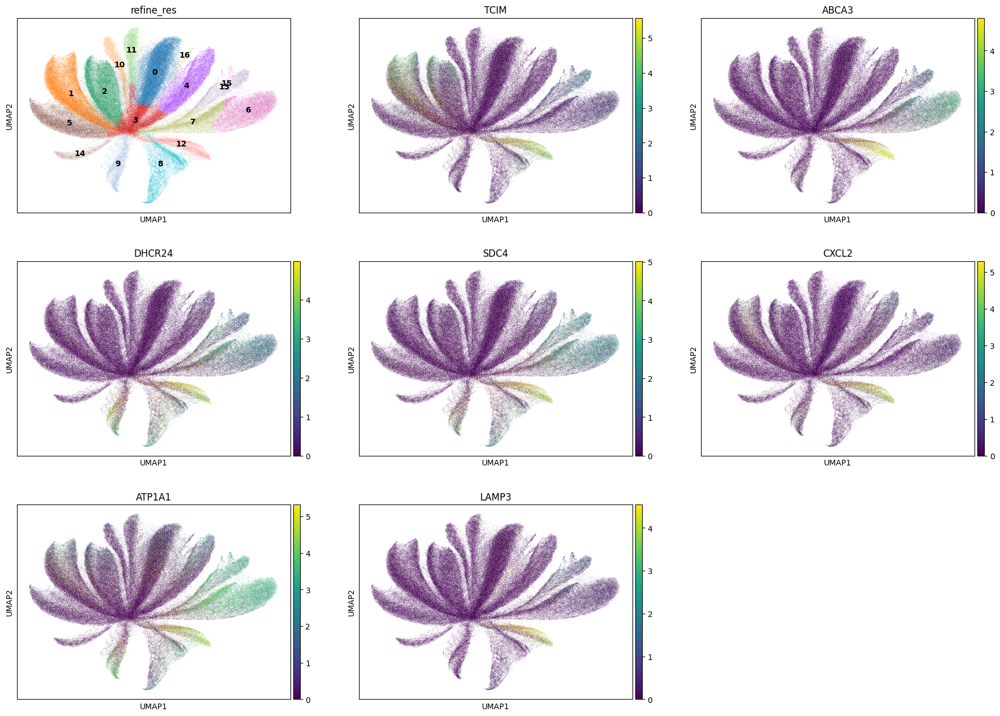

In [119]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [120]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 7663
Percentage of cells in cluster 12: 2.9


In [121]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_alveolar_typeII_epithelial_cell'

### 5.14. Cluster 13

In [122]:
cluster_id = '13'

In [123]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
91,13,M1 macrophage,26
92,13,Alveolar macrophage,15
93,13,Memory CD4 T cell,6
94,13,CD16 monocyte,6
95,13,Naive B cell,5
96,13,AT1,4
97,13,CD16 NK cell,4


In [124]:
top_ranked_genes[cluster_id]

0     LPCAT1
1      NDRG1
2      EPCAM
3    CLPTM1L
4       CDH1
5     NKX2-1
6       PLS3
Name: 13, dtype: object

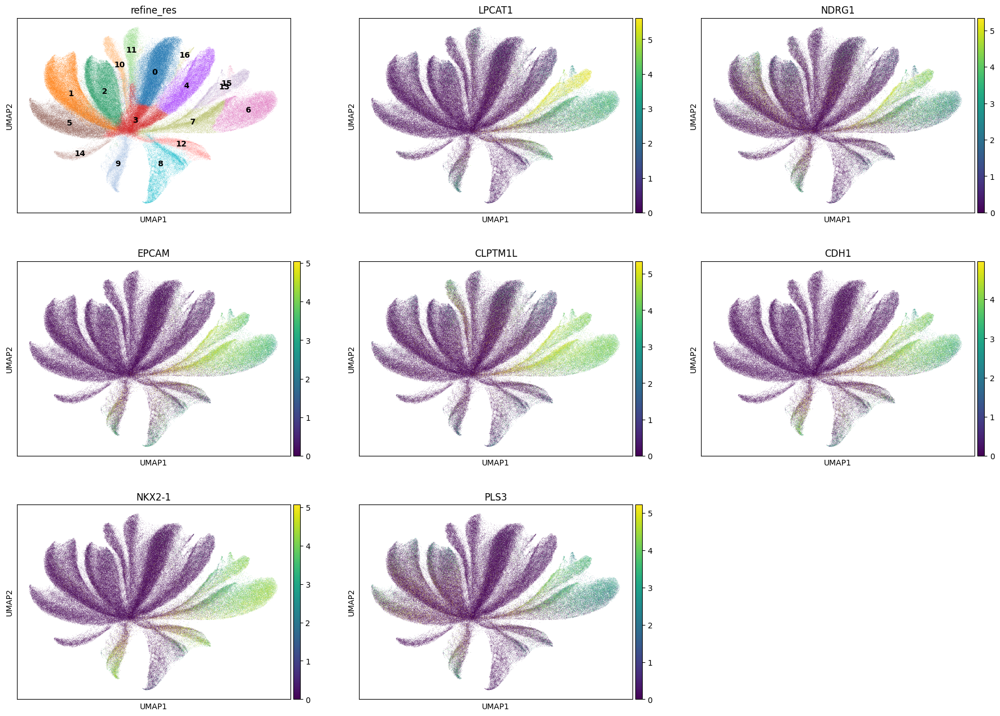

In [125]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [126]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 13: 7211
Percentage of cells in cluster 13: 2.7


In [127]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_alveolar_typeII_epithelial_cell'

### 5.15. Cluster 14

In [128]:
cluster_id = '14'

In [129]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
98,14,Mast cell,56
99,14,Neuroendocrine cell,13
100,14,Naive B cell,3
101,14,Red blood cell,3
102,14,mregDC,2
103,14,LYVE1 macrophage,2
104,14,CD16 monocyte,2


In [130]:
top_ranked_genes[cluster_id]

0        KIT
1        HDC
2      GATA2
3     IL1RL1
4    SLC18A2
5      MS4A2
6      ALOX5
Name: 14, dtype: object

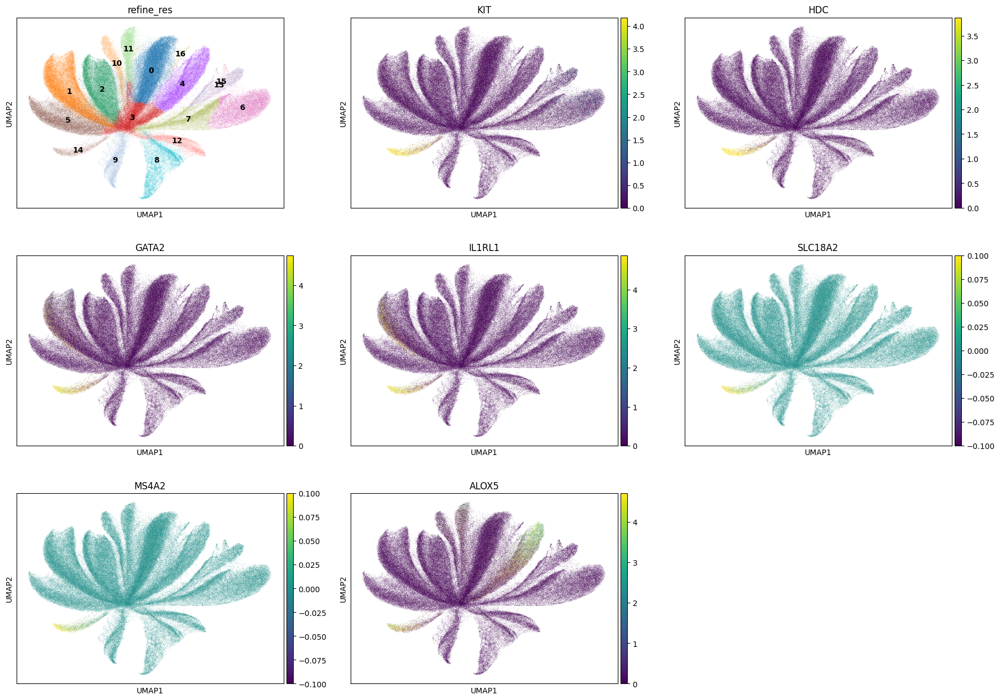

In [131]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [132]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 14: 3669
Percentage of cells in cluster 14: 1.4


In [133]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.16. Cluster 15

In [134]:
cluster_id = '15'

In [135]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
105,15,M1 macrophage,37
106,15,Alveolar macrophage,16
107,15,Naive B cell,9
108,15,Cycling T/NK cell,7
109,15,CD16 monocyte,6
110,15,Memory CD4 T cell,6
111,15,CD16 NK cell,3


In [136]:
top_ranked_genes[cluster_id]

0    CLPTM1L
1      PDIA4
2        NMU
3      TOP2A
4      EPCAM
5       CTSH
6        TK1
Name: 15, dtype: object

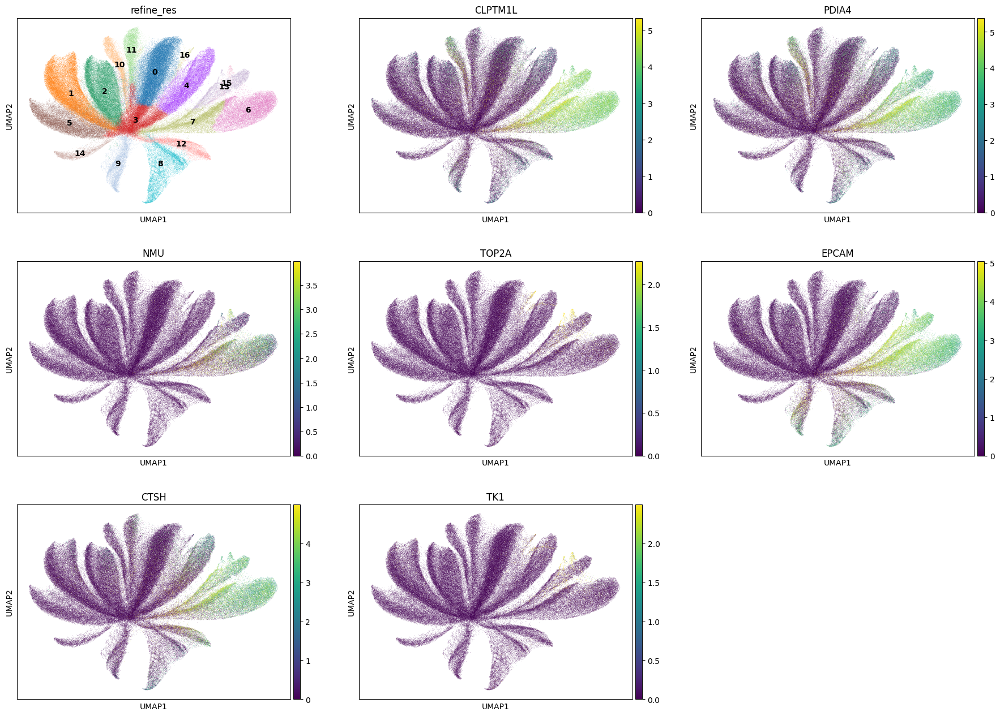

In [137]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [138]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 15: 889
Percentage of cells in cluster 15: 0.3


In [139]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_proliferating_epithelial_cell'

### 5.17. Cluster 16

In [140]:
cluster_id = '16'

In [141]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
112,16,Cycling T/NK cell,23
113,16,Memory CD4 T cell,19
114,16,Naive B cell,18
115,16,Treg cell,12
116,16,CD16 monocyte,9
117,16,GZMB CD8 T cell,7
118,16,CD16 NK cell,5


In [142]:
top_ranked_genes[cluster_id]

0     TUBB
1     CD3E
2    STMN1
3     PCNA
4     CD8A
5    CTLA4
6     TYMS
Name: 16, dtype: object

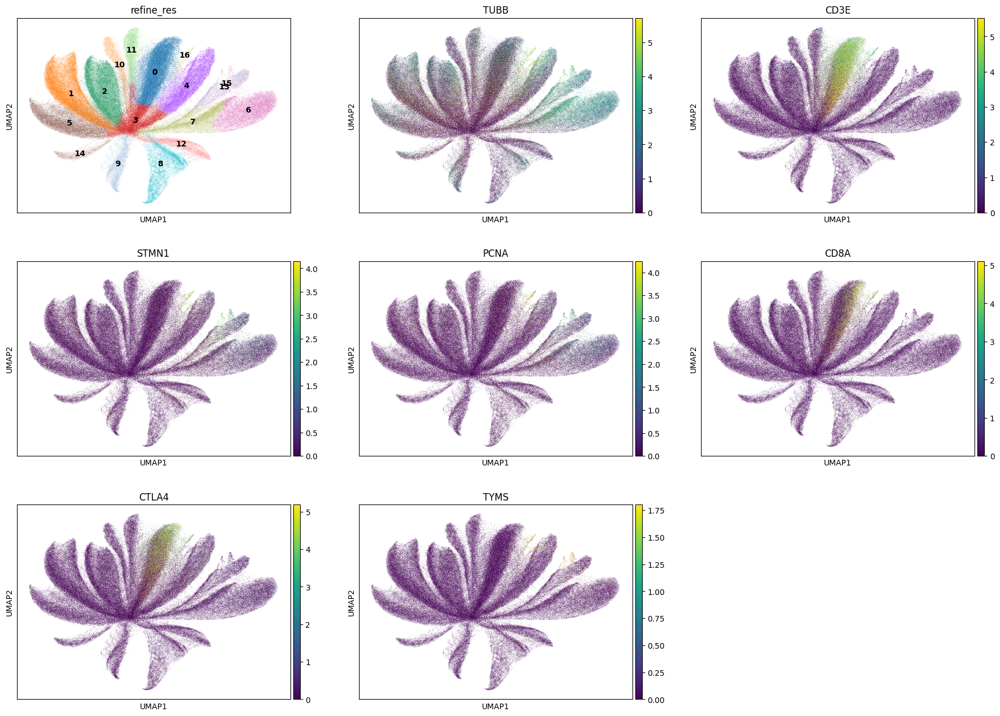

In [143]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [144]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 16: 643
Percentage of cells in cluster 16: 0.2


In [145]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T'

## 6. Cancer cells

In [146]:
adata.obs['label1'].unique()

array(['T', 'Unknown', 'Perivascular', 'B', 'Epithelial', 'Endothelial',
       'Plasma', 'Monocyte/Macrophage', 'Fibroblast', 'Mast'],
      dtype=object)

In [147]:
adata.obs['label2'].unique()

array(['T', 'Unknown', 'Pericyte/Smooth_muscle', 'B',
       'Lung_epithelial_cell', 'Endothelial', 'Plasma',
       'Monocyte/Macrophage', 'Lung_proliferating_epithelial_cell', 'CAF',
       'Mast', 'Lung_ciliated_epithelial_cell',
       'Lung_alveolar_typeII_epithelial_cell',
       'Lung_alveolar_typeI_epithelial_cell'], dtype=object)

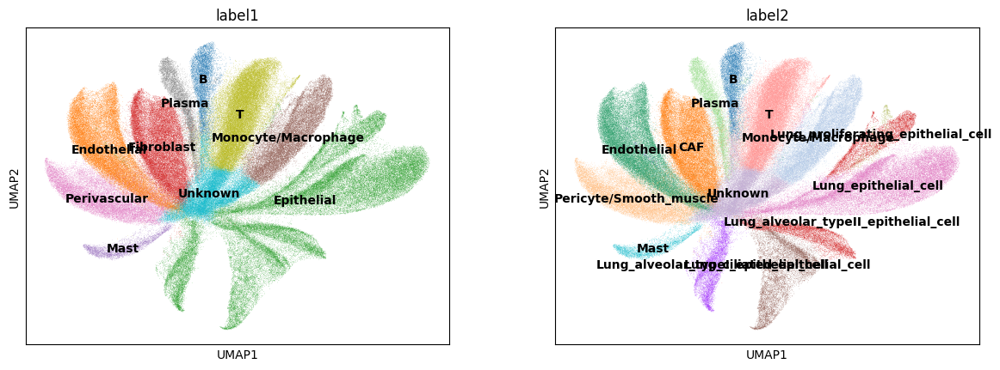

In [148]:
sc.pl.umap(adata, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [149]:
# Pathway analysis using KEGG pathways # https://www.genome.jp/brite/br08901

s = KEGG()
data = s.get("hsa05223")
dict_data = s.parse(data)
genes_cancer_ref = [info.split(';')[0] for info in dict_data['GENE'].values()]

print(dict_data['NAME'])

['Non-small cell lung cancer - Homo sapiens (human)']


In [152]:
genes_cancer = list(set(adata.var_names.tolist()).intersection(genes_cancer_ref))
len(genes_cancer)

59

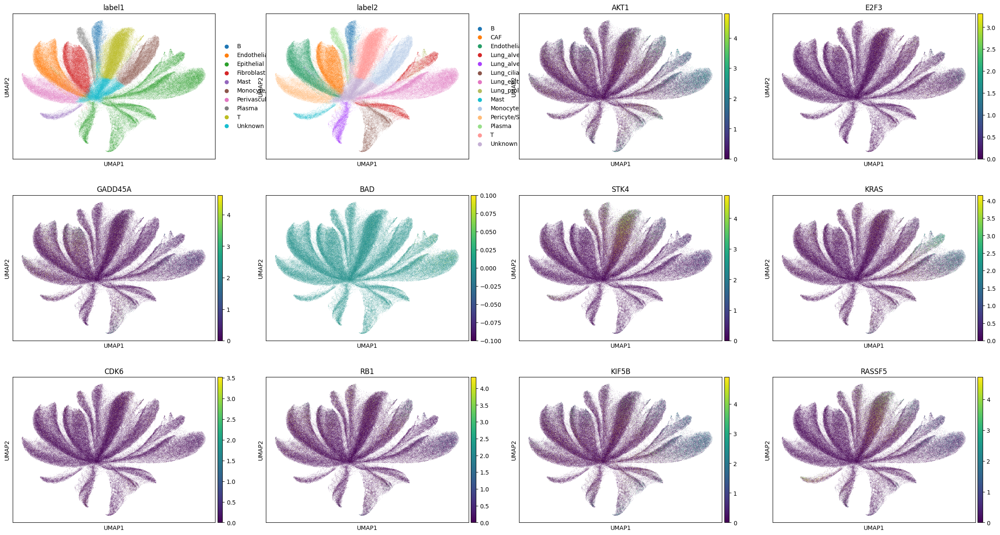

In [153]:
sc.pl.umap(adata, color=['label1', 'label2'] + genes_cancer[:10], vmax="p99", vmin=0, ncols=4)

In [155]:
for l in adata.obs['label2'].unique():
    print(l)

T
Unknown
Pericyte/Smooth_muscle
B
Lung_epithelial_cell
Endothelial
Plasma
Monocyte/Macrophage
Lung_proliferating_epithelial_cell
CAF
Mast
Lung_ciliated_epithelial_cell
Lung_alveolar_typeII_epithelial_cell
Lung_alveolar_typeI_epithelial_cell


In [156]:
# Cancer cells
adata.obs['label3'] = 'normal_cell'
adata.obs.loc[adata.obs['label2'].isin(['Lung_epithelial_cell', 'Lung_proliferating_epithelial_cell', 'Lung_alveolar_typeII_epithelial_cell']), 'label3'] = 'cancer_cell'

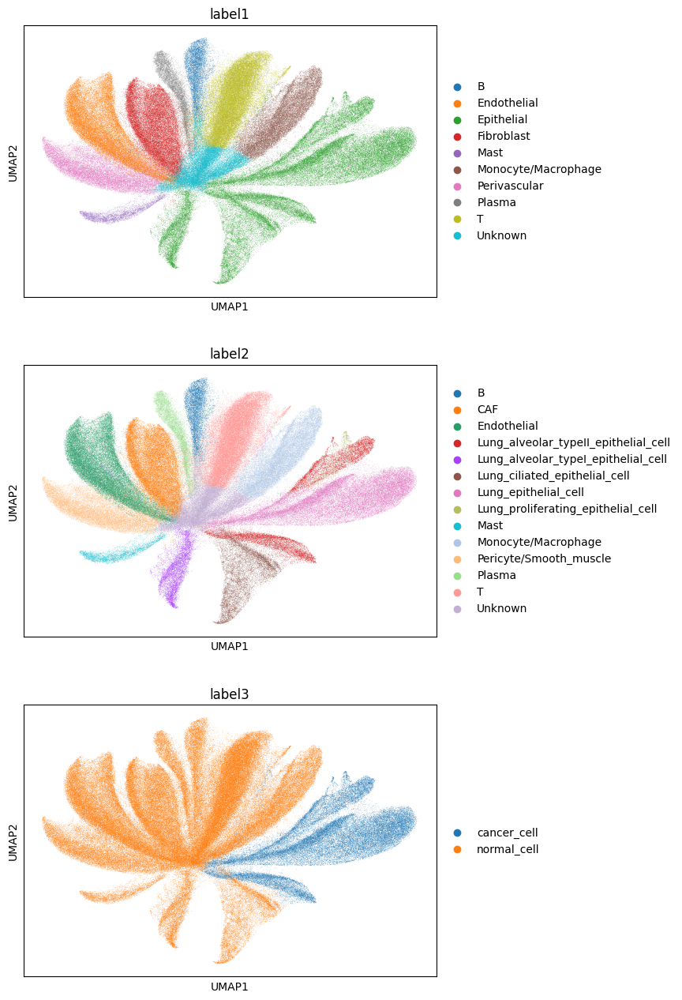

In [157]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [158]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,19.574901,Club cell,132,1,0,5,0,T,T,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,8.737764,Neuroendocrine cell,41,1,3,2,3,Unknown,Unknown,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,24.090059,CD16 NK cell,212,1,0,5,0,T,T,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,19.079021,Memory CD4 T cell,184,1,0,5,0,T,T,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,25.423266,CD16 NK cell,244,1,0,5,0,T,T,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaaedcpm-1,nucleus_boundaries,morpho,aaaedcpm-1,15.510612,Neuroendocrine cell,27,4,3,9,3,Unknown,Unknown,normal_cell
aaaeddaa-1,nucleus_boundaries,morpho,aaaeddaa-1,4.040921,Neuroendocrine cell,18,2,1,0,1,Endothelial,Endothelial,normal_cell
aaaeddac-1,nucleus_boundaries,morpho,aaaeddac-1,38.586490,Goblet cell,81,4,3,9,3,Unknown,Unknown,normal_cell
aaaeddae-1,nucleus_boundaries,morpho,aaaeddae-1,25.874608,Red blood cell,76,4,7,7,7,Epithelial,Lung_epithelial_cell,cancer_cell


In [159]:
adata.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")